In [324]:
import preprocessing
import plots

import os
import random
import pandas as pd
import numpy as np
import scanpy as sc
import anndata as ad
from scipy import sparse
import scanpy.external as sce
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
from anndata import ImplicitModificationWarning

warnings.filterwarnings("ignore", category=ImplicitModificationWarning)

In [348]:
sc.settings.verbosity = 0
sc.set_figure_params(dpi=150, dpi_save=300, frameon=False, format='png')
pd.set_option('display.max_rows', 5000)
plt.rcParams['axes.grid'] = False

### 1. Preprocessing, PBMC clustering

Adata object created!

Run QC and preprocessing...
Total number of cells: 405702
Number of cells after filtering of low quality cells: 374267

Normalizing, logarithming...

Select HVG...


/opt/conda/envs/scenv/lib/python3.11/site-packages/scanpy/preprocessing/_scale.py:299: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


TypeError: Can't implicitly convert non-string objects to strings

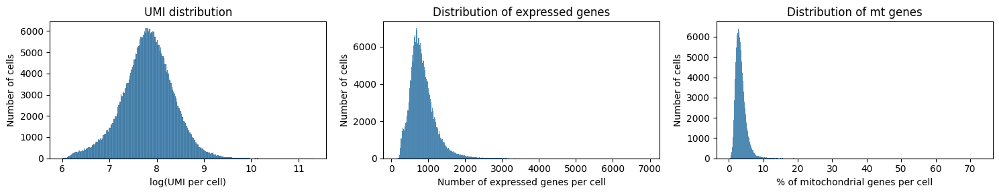

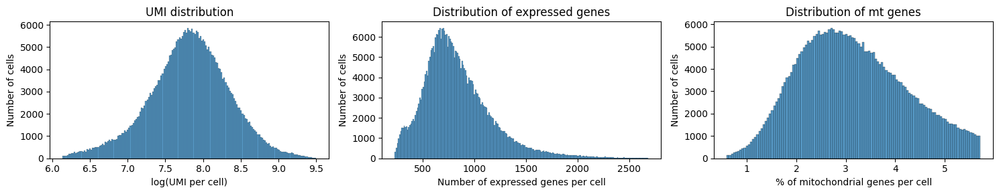

In [2]:
SEED = 600
random.seed(SEED)  # have to call random.seed() with the same value prior to every invocation of random.sample()
np.random.seed(SEED)

n_batches = 1
n_samples = 200
samples_path = './single_matrices/'

for batch in range(1, n_batches+1):
    adata = preprocessing.get_adata_from_multiple_samples(samples_path, n_samples, make_sparse=True)
    output_path = f'./output/batch_{batch}'
    if not os.path.exists(output_path):
        os.makedirs(output_path)
    adata.obs.to_csv(f'{output_path}/metadata.csv')
    print('Adata object created!')

    print('\nRun QC and preprocessing...')
    adata = preprocessing.qc_and_preprocess_to_pca(adata, output_path)
    adata.write(os.path.join(output_path, 'adata_after_QC.h5ad'))
    print('\nQC and preprocessing done!')

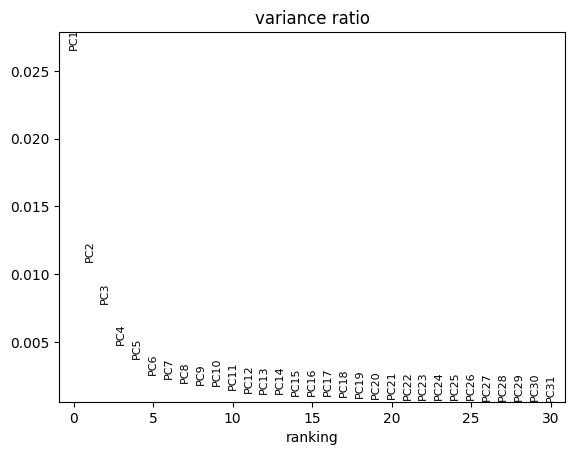

In [11]:
sc.pl.pca_variance_ratio(adata)

In [2]:
adata = sc.read_h5ad('adata_leiden_main.h5ad')

In [3]:
adata

AnnData object with n_obs × n_vars = 374267 × 3000
    obs: 'nCount_RNA', 'nFeature_RNA', 'donor_id', 'pool_number', 'predicted.celltype.l2', 'predicted.celltype.l2.score', 'age', 'sex', 'dataset', 'ct_cov', 'ethnicity', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'outlier', 'mt_outlier', 'n_genes', 'leiden'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'leiden_sizes', 'log1p', 'neighbors', 'paga', 'pca', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [51]:
# 3. BATCH CORRECTION
sce.pp.harmony_integrate(adata, 'donor_id', max_iter_harmony=20)

# 4. CLUSTERING
sc.pp.neighbors(
    adata,
    n_pcs=20,
    n_neighbors=20,
    knn=True,
    use_rep="X_pca_harmony"
)

print('\nClustering...')
sc.tl.leiden(adata, resolution=0.6, flavor='igraph')
print('\nMake dendrogram...')
sc.tl.dendrogram(adata, groupby="leiden", n_pcs=20, use_rep="X_pca_harmony", linkage_method="single")

sc.tl.paga(adata)
sc.pl.paga(adata, plot=False)
sc.tl.umap(adata, init_pos='paga')

adata.write(os.path.join(output_path, 'adata_leiden_main.h5ad'))



Clustering...

Make dendrogram...
CPU times: user 15.4 s, sys: 842 ms, total: 16.2 s
Wall time: 16.1 s


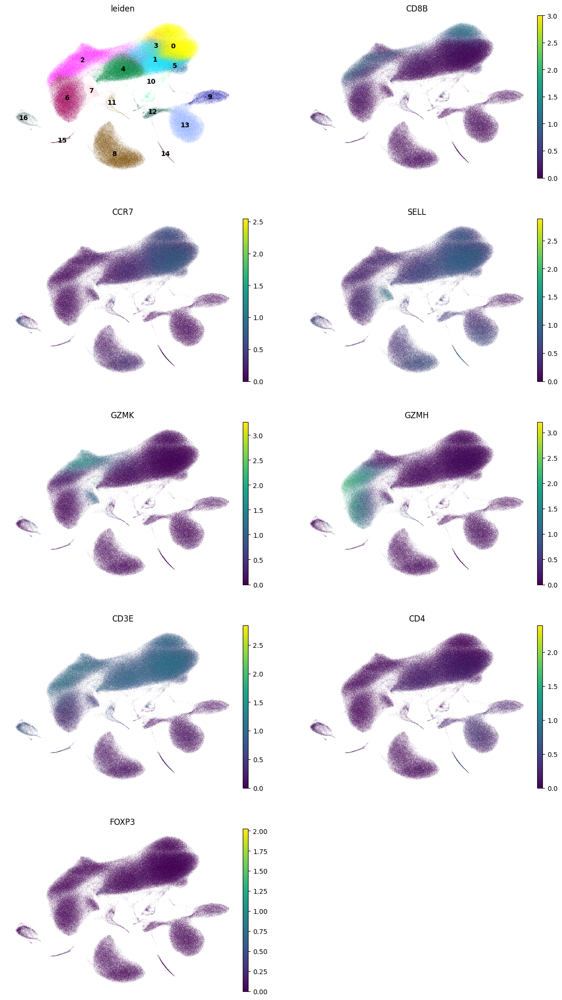

In [75]:
sc.pl.umap(adata, color=['leiden', 'CD8B', 'CCR7', 'SELL', 'GZMK', 'GZMH', 'CD3E', 'CD4', 'FOXP3'], frameon=False, ncols=2, legend_loc="on data")

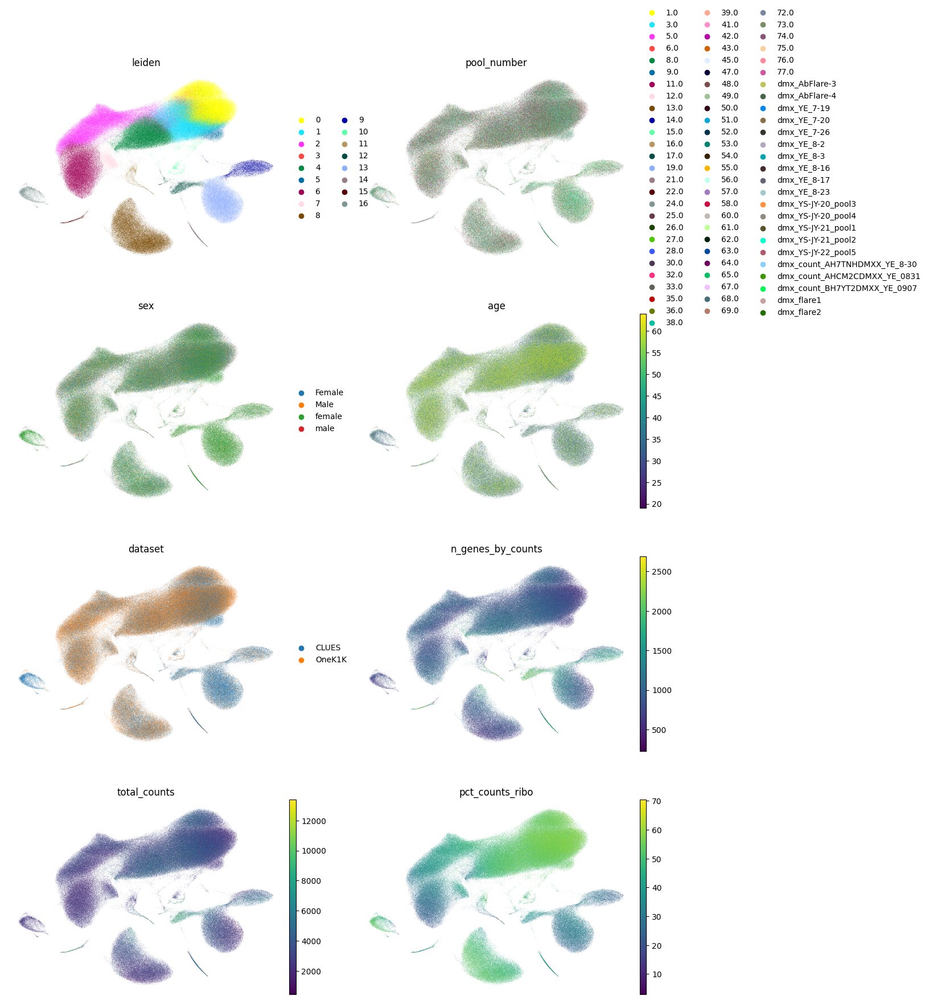

In [52]:
sc.pl.umap(adata, color=['leiden', 'pool_number', 'sex', 'age', 'dataset', 'n_genes_by_counts', 'total_counts', 'pct_counts_ribo'], frameon=False, ncols=2)

In [46]:
adata

AnnData object with n_obs × n_vars = 374267 × 3000
    obs: 'nCount_RNA', 'nFeature_RNA', 'donor_id', 'pool_number', 'predicted.celltype.l2', 'predicted.celltype.l2.score', 'age', 'sex', 'dataset', 'ct_cov', 'ethnicity', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'outlier', 'mt_outlier', 'n_genes', 'leiden'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'leiden_sizes', 'log1p', 'neighbors', 'paga', 'pca', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

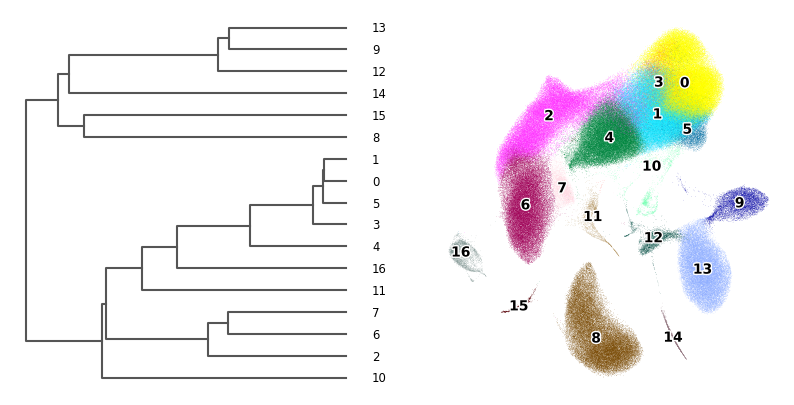

In [54]:
plots.plot_leiden_clusters(adata) #, save_fig_to=output_path, suffix='all')

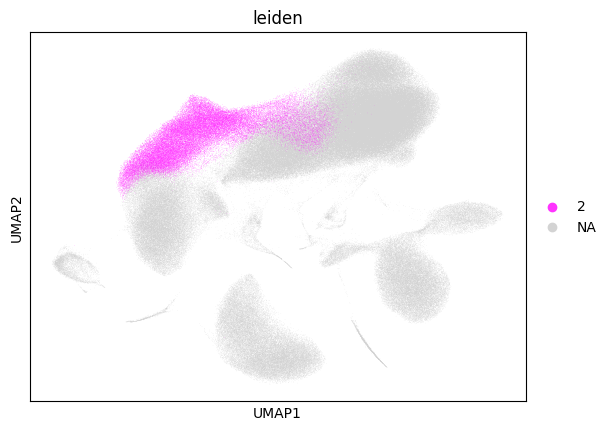

In [58]:
sc.pl.umap(adata, color='leiden', groups='2')

In [88]:
sc.tl.leiden(adata, resolution=1, flavor='igraph', restrict_to=('leiden', ['0', '1', '2']))

In [62]:
adata

AnnData object with n_obs × n_vars = 374267 × 3000
    obs: 'nCount_RNA', 'nFeature_RNA', 'donor_id', 'pool_number', 'predicted.celltype.l2', 'predicted.celltype.l2.score', 'age', 'sex', 'dataset', 'ct_cov', 'ethnicity', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'outlier', 'mt_outlier', 'n_genes', 'leiden', 'leiden_R'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'leiden_sizes', 'log1p', 'neighbors', 'paga', 'pca', 'umap', 'pool_number_colors', 'sex_colors', 'dataset_colors', 'leiden_R'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    la

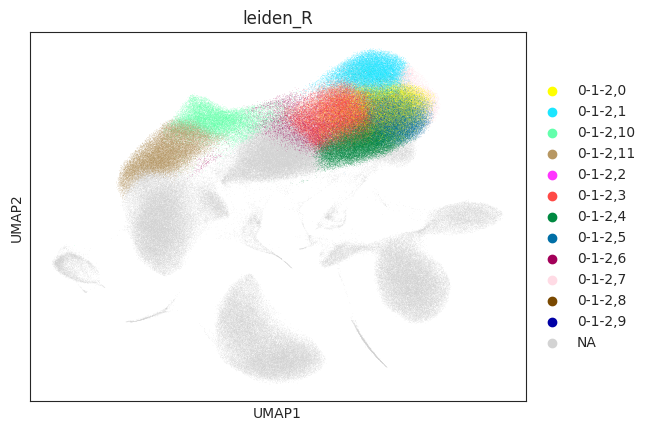

In [108]:
sc.pl.umap(adata, color='leiden_R', groups=[n if n.startswith('0-1-2') else None for n in adata.obs['leiden_R'].unique()])

### 2. PBMC annotation with `celltypist`

In [32]:
import celltypist
from celltypist import models

In [34]:
adata_celltypist = adata.copy()  # make a copy of our adata
adata_celltypist.X = adata.layers["counts"]  # set adata.X to raw counts
sc.pp.normalize_per_cell(
    adata_celltypist, counts_per_cell_after=10**4
)  # normalize to 10,000 counts per cell
sc.pp.log1p(adata_celltypist)  # log-transform
# make .X dense instead of sparse, for compatibility with celltypist:
adata_celltypist.X = adata_celltypist.X.toarray()

In [41]:
models.download_models(force_update = True)

In [42]:
models.models_description()

,model,description
0,Immune_All_Low.pkl,immune sub-populations combined from 20 tissue...
1,Immune_All_High.pkl,immune populations combined from 20 tissues of...
2,Adult_CynomolgusMacaque_Hippocampus.pkl,cell types from the hippocampus of adult cynom...
3,Adult_Human_PancreaticIslet.pkl,cell types from pancreatic islets of healthy a...
4,Adult_Human_Skin.pkl,cell types from human healthy adult skin
5,Adult_Mouse_Gut.pkl,cell types in the adult mouse gut combined fro...
6,Adult_Mouse_OlfactoryBulb.pkl,cell types from the olfactory bulb of adult mice
7,Adult_Pig_Hippocampus.pkl,cell types from the adult pig hippocampus
8,Adult_RhesusMacaque_Hippocampus.pkl,cell types from the hippocampus of adult rhesu...
9,Autopsy_COVID19_Lung.pkl,cell types from the lungs of 16 SARS-CoV-2 inf...


In [45]:
model_pbmc = models.Model.load(model="Healthy_COVID19_PBMC.pkl")

In [46]:
model_pbmc.description

{'date': '2022-03-10 05:08:08.224597',
 'details': 'peripheral blood mononuclear cell types from healthy and COVID-19 individuals',
 'url': 'https://celltypist.cog.sanger.ac.uk/models/COVID19_PBMC_Haniffa/v1/Healthy_COVID19_PBMC.pkl',
 'source': 'https://doi.org/10.1038/s41591-021-01329-2',
 'version': 'v1',
 'number_celltypes': 51}

In [47]:
model_pbmc.cell_types

array(['ASDC', 'B_exhausted', 'B_immature', 'B_malignant', 'B_naive',
       'B_non-switched_memory', 'B_switched_memory', 'C1_CD16_mono',
       'CD14_mono', 'CD16_mono', 'CD4.CM', 'CD4.EM', 'CD4.IL22',
       'CD4.Naive', 'CD4.Prolif', 'CD4.Tfh', 'CD4.Th1', 'CD4.Th17',
       'CD4.Th2', 'CD8.EM', 'CD8.Naive', 'CD8.Prolif', 'CD8.TE',
       'CD83_CD14_mono', 'DC1', 'DC2', 'DC3', 'DC_prolif', 'HSC_CD38neg',
       'HSC_CD38pos', 'HSC_MK', 'HSC_erythroid', 'HSC_myeloid',
       'HSC_prolif', 'ILC1_3', 'ILC2', 'MAIT', 'Mono_prolif', 'NKT',
       'NK_16hi', 'NK_56hi', 'NK_prolif', 'Plasma_cell_IgA',
       'Plasma_cell_IgG', 'Plasma_cell_IgM', 'Plasmablast', 'Platelets',
       'RBC', 'Treg', 'gdT', 'pDC'], dtype=object)

In [48]:
ct_preds = celltypist.annotate(
    adata_celltypist,
    model=model_pbmc,
    majority_voting=True
)

In [49]:
ct_preds_adata = ct_preds.to_adata()

In [50]:
adata.obs["celltypist_annotation"] = ct_preds_adata.obs.loc[adata.obs.index, "majority_voting"]
adata.obs["celltypist_conf_score"] = ct_preds_adata.obs.loc[adata.obs.index, "conf_score"]

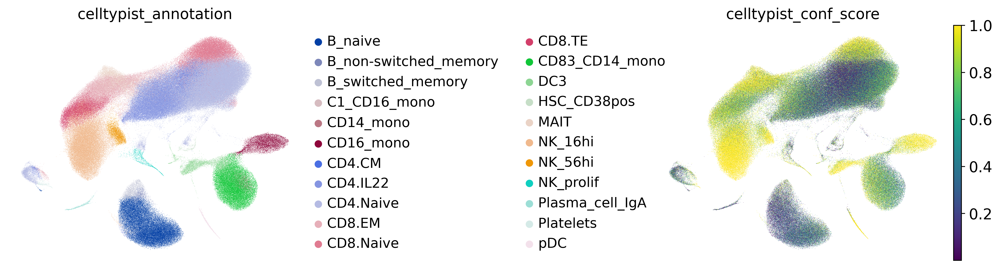

In [98]:
sc.pl.umap(
    adata,
    color=["celltypist_annotation", "celltypist_conf_score"],
    frameon=False,
    sort_order=False,
    wspace=1,
    # groups='MAIT'
)

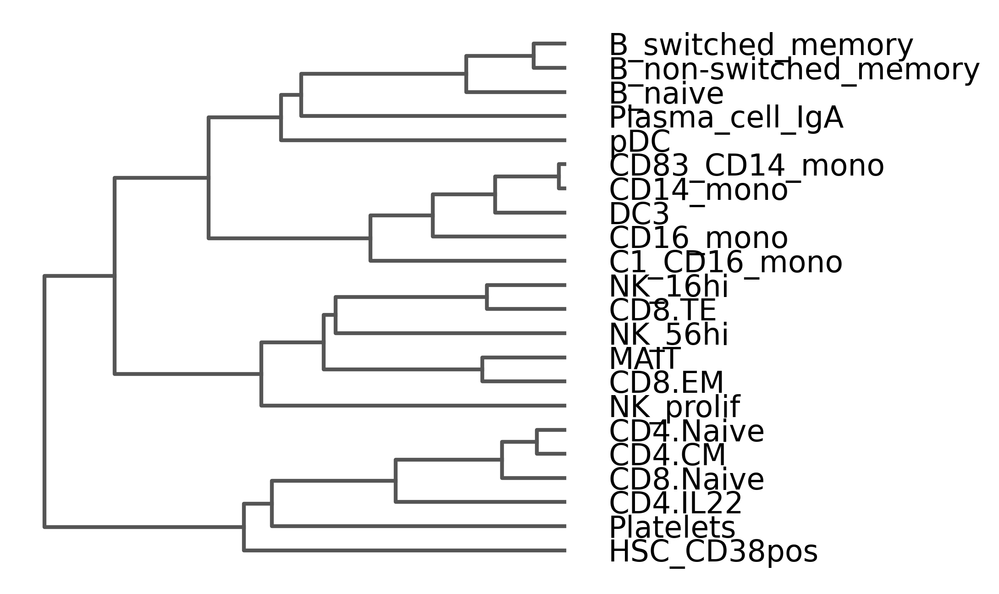

<Axes: >

In [54]:
sc.pl.dendrogram(adata, groupby="celltypist_annotation", orientation='left')

In [55]:
adata.write('adata_COVID_annotated.h5ad')

In [56]:
adata.obs['celltypist_annotation'].value_counts()

CD4.Naive                114544
CD4.IL22                  53352
NK_16hi                   40756
B_naive                   35023
CD8.Naive                 28845
CD83_CD14_mono            26239
CD8.EM                    25108
CD8.TE                    13011
MAIT                       8630
CD16_mono                  7507
DC3                        6036
NK_56hi                    3564
CD4.CM                     3150
B_switched_memory          2165
pDC                        1543
CD14_mono                  1194
B_non-switched_memory      1125
NK_prolif                  1029
Plasma_cell_IgA             669
Platelets                   328
HSC_CD38pos                 309
C1_CD16_mono                140
Name: celltypist_annotation, dtype: int64

### 3. Select CD8 clusters

In [64]:
adata = sc.read_h5ad('adata_COVID_annotated.h5ad')

In [85]:
adata_cd8.obs['sex'][adata_cd8.obs['sex'] == 'female'] = 'Female'
adata_cd8.obs['sex'][adata_cd8.obs['sex'] == 'male'] = 'Male'
adata_cd8.obs['sex'] = adata_cd8.obs['sex'].astype('object')
adata_cd8.obs['sex'] = adata_cd8.obs['sex'].astype('category')

In [66]:
adata_cd8 = adata[[type in ('CD8.Naive', 'CD8.EM', 'CD8.TE', 'MAIT') for type in adata.obs['celltypist_annotation']]]
adata_cd8 = adata_cd8[[cluster not in ('0-1-2,4', '4', '5', '16') for cluster in adata_cd8.obs['leiden_R']]]

In [67]:
(adata_cd8.X.T[adata_cd8.var_names == 'CD4'] > 0.5).sum()

1992

In [68]:
# drop CD4+ cells:
adata_cd8 = adata_cd8[adata_cd8.X.T[adata_cd8.var_names == 'CD4'] < 0.5]

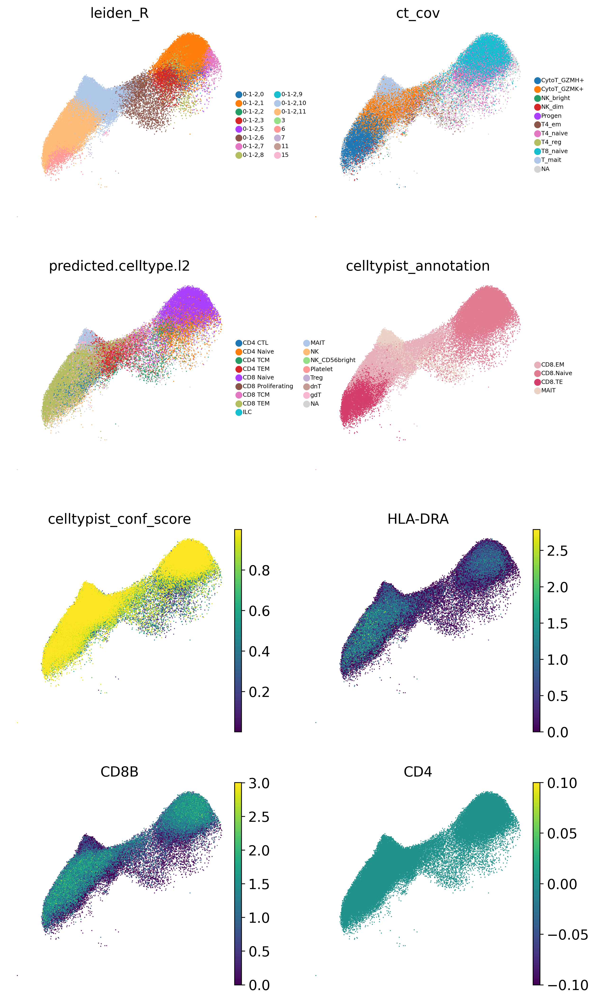

In [69]:
sc.pl.umap(adata_cd8, 
           color=['leiden_R', 'ct_cov', 'predicted.celltype.l2', 'celltypist_annotation', 'celltypist_conf_score', 'HLA-DRA', 'CD8B', 'CD4'], 
           ncols=2, frameon=False, size=4, legend_fontsize=6
           )

In [70]:
# return raw counts
adata_cd8.X = adata_cd8.layers['counts'].A.copy()

In [71]:
sc.pp.normalize_total(adata_cd8)
sc.pp.log1p(adata_cd8)

sc.pp.scale(adata_cd8)
sc.tl.pca(adata_cd8)

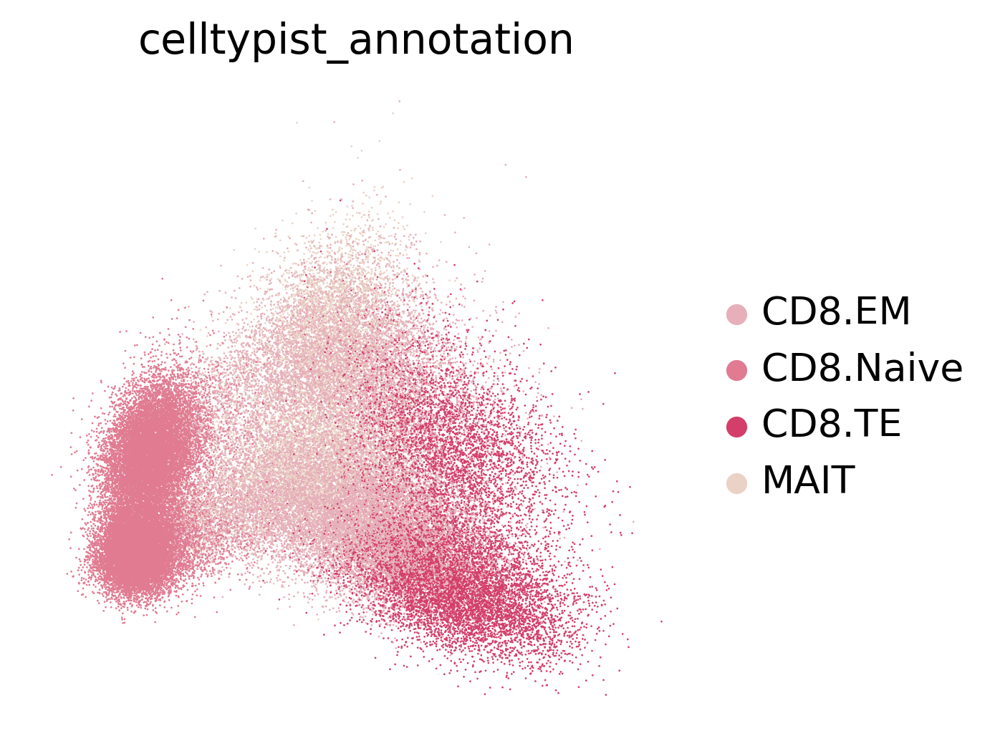

In [72]:
sc.pl.pca_scatter(adata_cd8, color='celltypist_annotation')

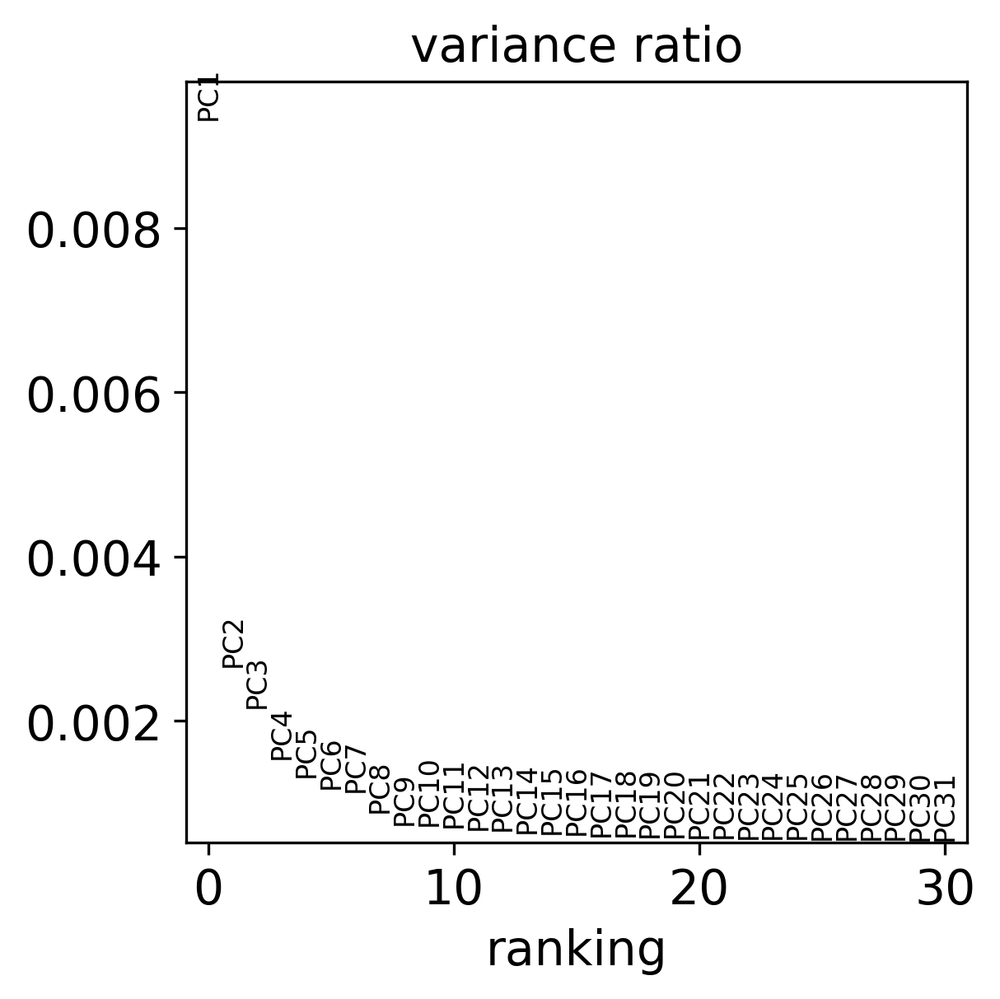

In [73]:
sc.pl.pca_variance_ratio(adata_cd8)

In [74]:
# 3. BATCH CORRECTION
sce.pp.harmony_integrate(adata_cd8, key='donor_id', max_iter_harmony=20)

2024-05-10 22:04:16,371 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
INFO:harmonypy:Computing initial centroids with sklearn.KMeans...
2024-05-10 22:04:20,777 - harmonypy - INFO - sklearn.KMeans initialization complete.
INFO:harmonypy:sklearn.KMeans initialization complete.
2024-05-10 22:04:21,086 - harmonypy - INFO - Iteration 1 of 20
INFO:harmonypy:Iteration 1 of 20
2024-05-10 22:04:58,284 - harmonypy - INFO - Iteration 2 of 20
INFO:harmonypy:Iteration 2 of 20
2024-05-10 22:05:34,592 - harmonypy - INFO - Iteration 3 of 20
INFO:harmonypy:Iteration 3 of 20
2024-05-10 22:06:09,921 - harmonypy - INFO - Iteration 4 of 20
INFO:harmonypy:Iteration 4 of 20
2024-05-10 22:06:43,766 - harmonypy - INFO - Iteration 5 of 20
INFO:harmonypy:Iteration 5 of 20
2024-05-10 22:07:11,731 - harmonypy - INFO - Iteration 6 of 20
INFO:harmonypy:Iteration 6 of 20
2024-05-10 22:07:38,328 - harmonypy - INFO - Iteration 7 of 20
INFO:harmonypy:Iteration 7 of 20
2024-05-10 22:08:06,163 - 

In [75]:
sc.pp.neighbors(
    adata_cd8,
    n_pcs=20,
    n_neighbors=15,
    knn=True,
    use_rep="X_pca_harmony"
)

In [76]:
sc.tl.leiden(adata_cd8, resolution=0.4, flavor='igraph', key_added='leiden_cd8')
sc.tl.dendrogram(adata_cd8, groupby="leiden_cd8", n_pcs=20, use_rep="X_pca_harmony", linkage_method="single")

In [77]:
sc.tl.paga(adata_cd8)
sc.pl.paga(adata_cd8, plot=False)
sc.tl.umap(adata_cd8, init_pos='paga')

In [78]:
adata_cd8.write_h5ad('adata_cd8_leiden.h5ad')

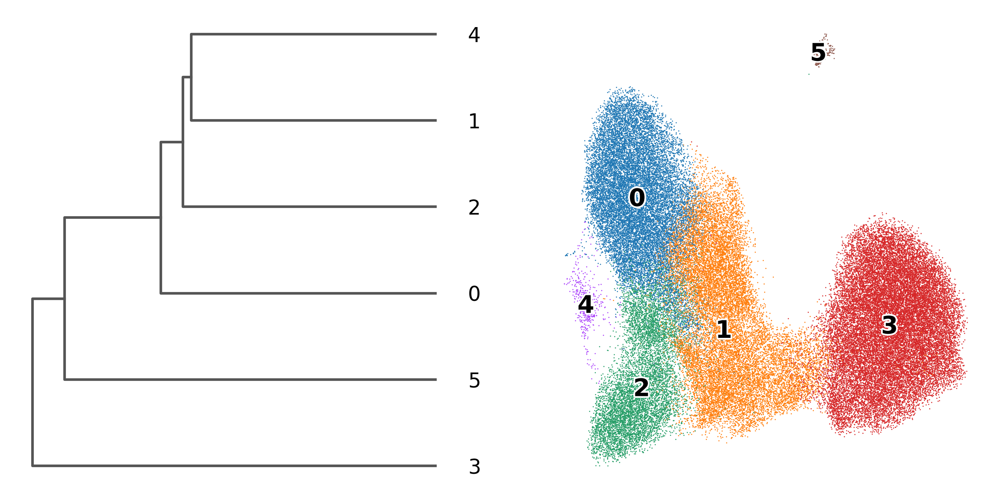

In [79]:
plots.plot_leiden_clusters(adata_cd8, leiden_key='leiden_cd8')

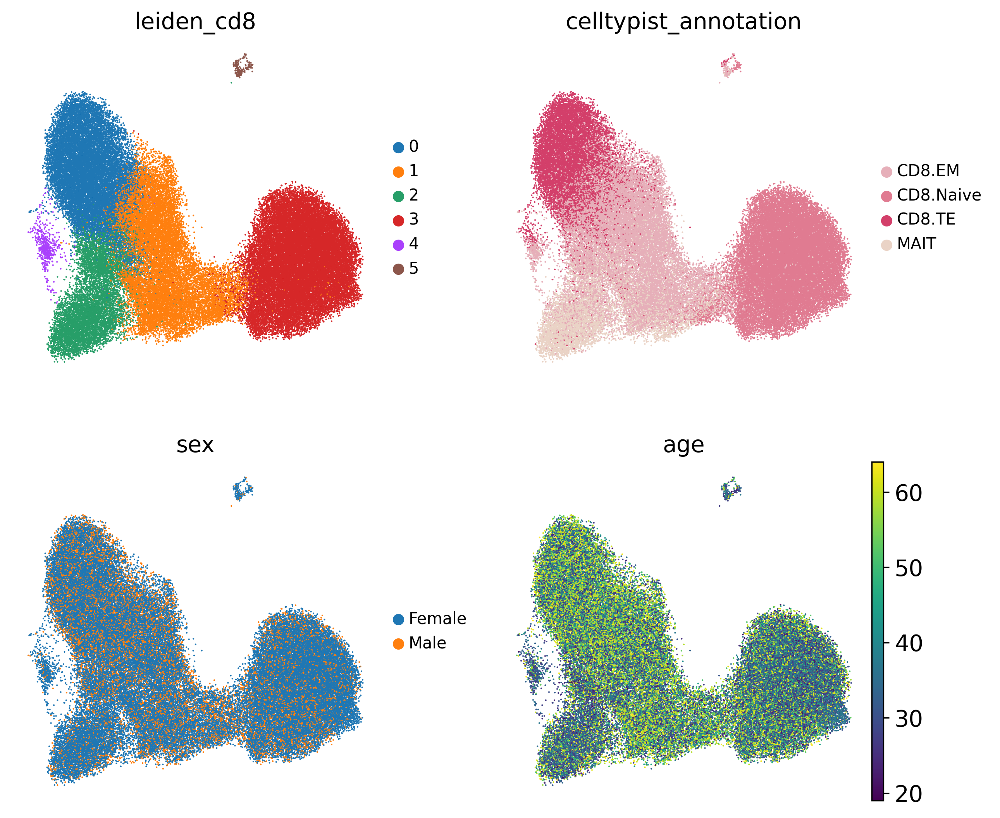

In [86]:
sc.pl.umap(adata_cd8, color=['leiden_cd8', 'celltypist_annotation', 'sex', 'age'], 
           frameon=False, 
           size=4, 
           ncols=2,
           legend_fontsize=10,
           sort_order=False
          ) 

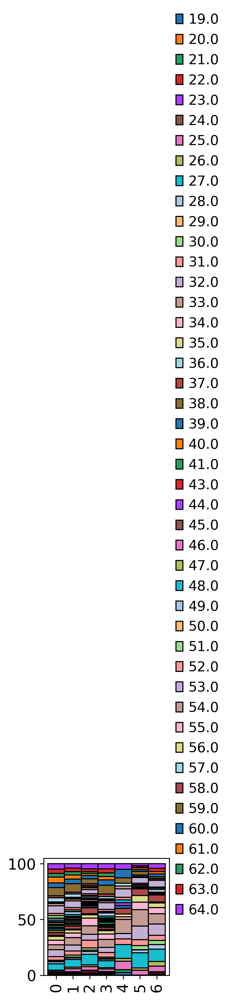

In [31]:
plots.barplot(adata_cd8, cluster_key='leiden_cd8', batch_key='age')

In [81]:
filtered = adata_cd8[(np.greater_equal(adata_cd8.X.T[adata_cd8.var_names == 'HLA-DRA'], 2) 
                      | np.greater_equal(adata_cd8.X.T[adata_cd8.var_names == 'HLA-DRB1'], 2)
                      | np.greater_equal(adata_cd8.X.T[adata_cd8.var_names == 'HLA-DRB5'], 2))
                    & np.less_equal(adata_cd8.X.T[adata_cd8.var_names == 'IL7R'], 0)]
adata_cd8.obs['is_CD8Treg'] = [name in list(filtered.obs_names) for name in adata_cd8.obs_names]

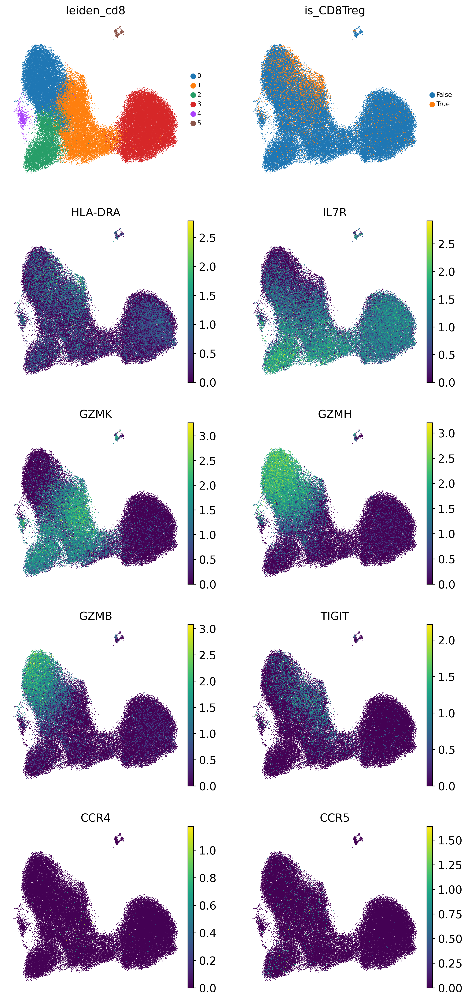

In [82]:
sc.pl.umap(adata_cd8, color=['leiden_cd8', 'is_CD8Treg', 'HLA-DRA', 'IL7R', 'GZMK', 'GZMH', 'GZMB', 'TIGIT', 'CCR4', 'CCR5'], 
           frameon=False, 
           size=4, 
           ncols=2,
           legend_fontsize=8,         
           # sort_order=False
          ) 

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


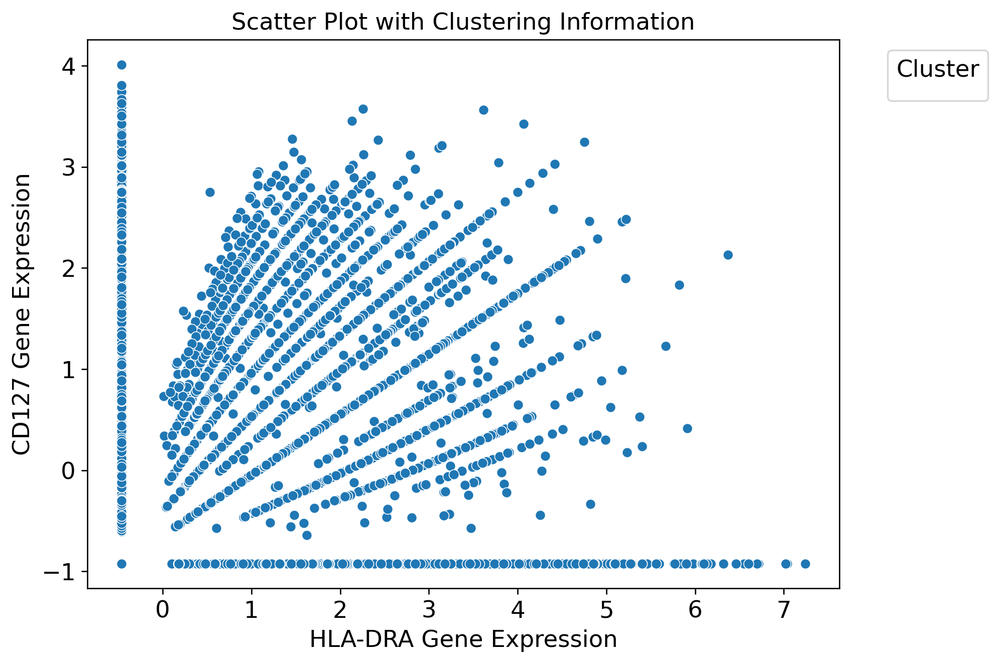

In [34]:
plt.figure(figsize=(8, 6))
colordict = {False: '#DDE2E6', True: '#D649B0'}
sns.scatterplot(x=adata_cd8.X.T[adata_cd8.var_names == 'HLA-DRA'][0],
                y=adata_cd8.X.T[adata_cd8.var_names == 'IL7R'][0], 
                # hue=adata_cd8.obs['leiden_cd8'] == '5',
                palette=colordict)

plt.xlabel('HLA-DRA Gene Expression')
plt.ylabel('CD127 Gene Expression')
plt.title('Scatter Plot with Clustering Information')

plt.legend(title='Cluster', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.show()

In [87]:
adata_cd8.write('adata_cd8_treg_tags.h5ad')

In [84]:
adata_cd8.obs.value_counts(subset=['celltypist_annotation', 'is_CD8Treg']) 
# Treg in CD8.EM 13%, in CD8.TE 21%, in Naive 3%

celltypist_annotation  is_CD8Treg
CD8.Naive              False         25982
CD8.EM                 False         20006
CD8.TE                 False          9831
MAIT                   False          7160
CD8.EM                 True           3196
CD8.TE                 True           2757
CD8.Naive              True            957
MAIT                   True            225
dtype: int64

#### Prep tags for DEA

In [3]:
adata_cd8 = sc.read_h5ad('adata_cd8_treg_tags.h5ad')

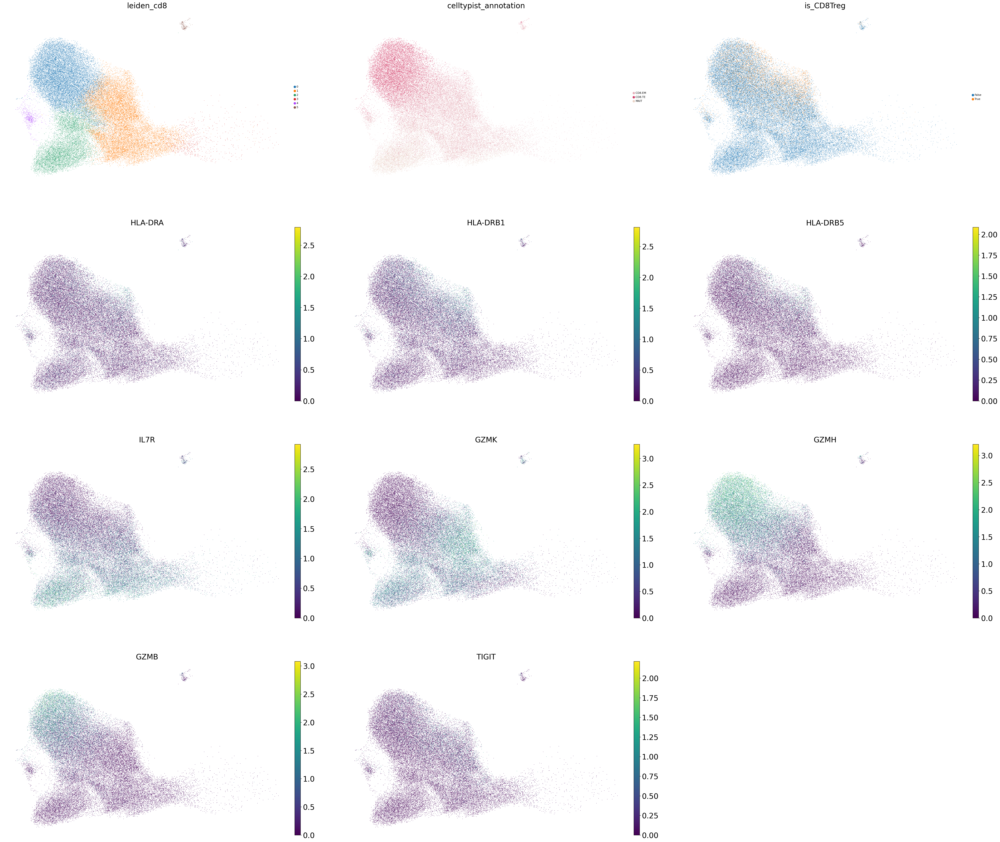

In [351]:
sc.pl.umap(adata_cd8, color=['leiden_cd8', 'celltypist_annotation', 'is_CD8Treg', 'HLA-DRA', 'HLA-DRB1', 
                             'HLA-DRB5', 'IL7R', 'GZMK', 'GZMH', 'GZMB', 'TIGIT'], 
           frameon=False, 
           size=4, 
           ncols=3,
           legend_fontsize=8,         
           # sort_order=False
          ) 

In [91]:
adata_cd8.obs['dea_labels'] = adata_cd8.obs['celltypist_annotation'].astype('object')
adata_cd8.obs['dea_labels'][(adata_cd8.obs['is_CD8Treg'] == True) & (adata_cd8.obs['celltypist_annotation'] != 'CD8.Naive')] = 'CD8.Treg'
adata_cd8.obs['dea_labels'] = adata_cd8.obs['dea_labels'].astype('category')

In [92]:
adata_cd8.write('adata_cd8_treg_tags.h5ad')

In [94]:
adata_cd8.obs['dea_labels'].value_counts()

CD8.Naive    26939
CD8.EM       20006
CD8.TE        9831
MAIT          7160
CD8.Treg      6178
Name: dea_labels, dtype: int64

### sc DEA

In [318]:
adata_cd8 = adata_cd8[adata_cd8.obs['dea_labels'] != 'CD8.Naive']

In [344]:
sc.tl.rank_genes_groups(adata_cd8, groupby='dea_labels', groups=['CD8.Treg', 'CD8.EM', 'CD8.TE', 'MAIT'], method='wilcoxon', pts=True)

In [321]:
df = sc.get.rank_genes_groups_df(adata_cd8, group='CD8.Treg', pval_cutoff=0.05)

In [322]:
df = df[~df.names.str.startswith('RP')]
df = df[df.pct_nz_group > 0.01]
df.sort_values(by='logfoldchanges', ascending=False, inplace=True)

In [327]:
adata_cd8

AnnData object with n_obs × n_vars = 43175 × 3000
    obs: 'nCount_RNA', 'nFeature_RNA', 'donor_id', 'pool_number', 'predicted.celltype.l2', 'predicted.celltype.l2.score', 'age', 'sex', 'dataset', 'ct_cov', 'ethnicity', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'outlier', 'mt_outlier', 'n_genes', 'leiden', 'leiden_R', 'celltypist_annotation', 'celltypist_conf_score', 'leiden_cd8', 'is_CD8Treg', 'dea_labels', 'bulk_sample'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'celltypist_annotation_colors', 'dataset_colors', 'dendrogram_celltypist_annotation', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_R', 'leide

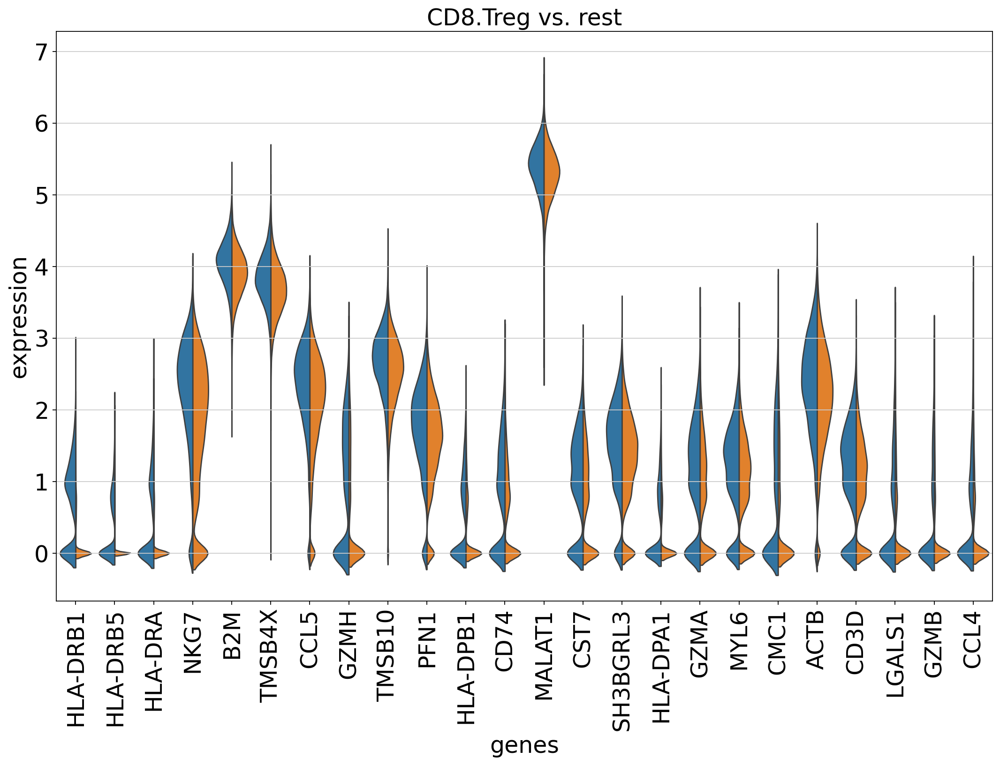

In [350]:
sc.set_figure_params(figsize=(16, 10), fontsize=22)
sc.pl.rank_genes_groups_violin(adata_cd8, n_genes=24, jitter=False, size=0, groups=['CD8.Treg'], save='.png')

In [304]:
with open('up_signs.txt', 'w') as f:
    for gene in df[df.logfoldchanges > 0.7].names.tolist():
        f.write(f'{gene}\n')
        

### pseudobulk DEA

In [111]:
import sc_toolbox

import rpy2.rinterface_lib.callbacks
import anndata2ri
import logging

from rpy2.robjects import pandas2ri
from rpy2.robjects import r

rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

pandas2ri.activate()
anndata2ri.activate()

%load_ext rpy2.ipython

INFO:rpy2.situation:cffi mode is CFFI_MODE.ANY
INFO:rpy2.situation:R home found: /usr/lib/R
INFO:rpy2.situation:R library path: /usr/lib/R/lib:/usr/lib/x86_64-linux-gnu::-:-/lib/server
INFO:rpy2.situation:LD_LIBRARY_PATH: /usr/lib/R/lib:/usr/lib/x86_64-linux-gnu::-:-/lib/server
INFO:rpy2.rinterface_lib.embedded:Default options to initialize R: rpy2, --quiet, --no-save
INFO:rpy2.rinterface_lib.embedded:R is already initialized. No need to initialize.


In [163]:
%%R
.libPaths("/home/student/R/x86_64-pc-linux-gnu-library/4.3")

library(edgeR)

In [95]:
adata_cd8

AnnData object with n_obs × n_vars = 70114 × 3000
    obs: 'nCount_RNA', 'nFeature_RNA', 'donor_id', 'pool_number', 'predicted.celltype.l2', 'predicted.celltype.l2.score', 'age', 'sex', 'dataset', 'ct_cov', 'ethnicity', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'outlier', 'mt_outlier', 'n_genes', 'leiden', 'leiden_R', 'celltypist_annotation', 'celltypist_conf_score', 'leiden_cd8', 'is_CD8Treg', 'dea_labels'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'celltypist_annotation_colors', 'dataset_colors', 'dendrogram_celltypist_annotation', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_R', 'leiden_sizes', 'log1

In [115]:
adata_cd8.obs["bulk_sample"] = [
    f"{pool}_{ct}" for pool, ct in zip(adata_cd8.obs["pool_number"], adata_cd8.obs["dea_labels"])
]

In [116]:
adata_cd8.obs["bulk_sample"] = adata_cd8.obs["bulk_sample"].astype('category')
adata_cd8.obs["pool_number"] = adata_cd8.obs["pool_number"].astype('category')
adata_cd8.obs["dea_labels"] = adata_cd8.obs["dea_labels"].astype('category')

In [117]:
def aggregate_and_filter(
    adata,
    # cell_identity,
    donor_key="bulk_sample",
    condition_key="dea_labels",
    # cell_identity_key="cell_type",
    obs_to_keep=[],  # which additional metadata to keep, e.g. gender, age, etc.
    replicates_per_patient=1,
    min_cells_per_donor=30
):
    """
    Creates an AnnData object with one pseudo-replicate for each donor for a specified 
    subpopulation from the original single-cell AnnData object. 
    Also it filters out donors that have fewer than `min_cells_per_donor' cells 
    for the specified population.

    By changing the `replicates_per_patient` parameter, 
    several (n) pseudo-replicates can be created for each sample; 
    cells are then split into n subsets of roughly equal sizes.
    """
    # subset adata to the given cell identity
    # adata_cell_pop = adata[adata.obs[cell_identity_key] == cell_identity].copy()
    adata_cell_pop = adata
    
    # check which donors to keep according to the number of cells specified with NUM_OF_CELL_PER_DONOR
    size_by_donor = adata_cell_pop.obs.groupby([donor_key]).size()
    donors_to_drop = [
        donor
        for donor in size_by_donor.index
        if size_by_donor[donor] <= min_cells_per_donor
    ]
    if len(donors_to_drop) > 0:
        print("Dropping the following samples:")
        print(donors_to_drop)
    df = pd.DataFrame(columns=[*adata_cell_pop.var_names, *obs_to_keep])

    adata_cell_pop.obs[donor_key] = adata_cell_pop.obs[donor_key].astype("category")
    
    for i, donor in enumerate(donors := adata_cell_pop.obs[donor_key].cat.categories):
        print(f"\tProcessing donor {i+1} out of {len(donors)}...", end="\r")
        
        if donor not in donors_to_drop:
            adata_donor = adata_cell_pop[adata_cell_pop.obs[donor_key] == donor]
            
            # create replicates for each donor
            indices = list(adata_donor.obs_names)
            random.shuffle(indices)
            indices = np.array_split(np.array(indices), replicates_per_patient)
            for i, rep_idx in enumerate(indices):
                adata_replicate = adata_donor[rep_idx]
                
                # specify how to aggregate: sum gene expression 
                # for each gene for each donor and also keep the condition information
                agg_dict = {gene: "sum" for gene in adata_replicate.var_names}
                for obs in obs_to_keep:
                    agg_dict[obs] = "first"
                    
                # create a df with all genes, donor and condition info
                df_donor = pd.DataFrame(adata_replicate.X.A)
                df_donor.index = adata_replicate.obs_names
                df_donor.columns = adata_replicate.var_names
                df_donor = df_donor.join(adata_replicate.obs[obs_to_keep])
                
                # aggregate
                df_donor = df_donor.groupby(donor_key).agg(agg_dict)
                df_donor[donor_key] = donor
                df.loc[f"donor_{donor}_{i}"] = df_donor.loc[donor]
    print("\n")
    
    # create AnnData object from the df
    adata_cell_pop = sc.AnnData(
        df[adata_cell_pop.var_names], obs=df.drop(columns=adata_cell_pop.var_names)
    )
    return adata_cell_pop

> define a separate function to fit an edgeR GLM

> `fit_model` takes a SingleCellExperiment object as input, creates the design matrix and outputs the fitted GLM. We also output the edgeR object of class DGEList to do some exploratory data analysis (EDA).

In [206]:
%%R
fit_model <- function(adata_){
    # create an edgeR object with counts and grouping factor
    y <- DGEList(assay(adata_, "X"), group = colData(adata_)$dea_labels)
    
    # filter out genes with low counts
    print("Dimensions before subsetting:")
    print(dim(y))
    print("")
    keep <- filterByExpr(y)
    y <- y[keep, , keep.lib.sizes=FALSE]
    print("Dimensions after subsetting:")
    print(dim(y))
    print("")

    # normalize
    y <- calcNormFactors(y)

    # create a vector that is a concatenation of condition and cell type 
    # that we will later use with contrasts
    ## group <- paste0(colData(adata_)$label, ".", colData(adata_)$cell_type)
    cell_type <- colData(adata_)$dea_labels
    dataset <- colData(adata_)$dataset

    # create a design matrix: 
    # here we have multiple donors so also consider that in the design matrix
    design <- model.matrix(~ 0 + cell_type)

    # estimate dispersion
    y <- estimateDisp(y, design = design)

    # fit the model
    fit <- glmQLFit(y, design)

    return(list("fit"=fit, "design"=design, "y"=y))
}

In [207]:
obs_to_keep = ['age', 'sex', 'pool_number', 'dataset', 'dea_labels', 'bulk_sample']

In [208]:
adata_to_bulk = adata_cd8.copy()
adata_to_bulk.X = adata_to_bulk.layers['counts'].copy()

In [209]:
# process first cell type separately...
adata_pb = aggregate_and_filter(adata_to_bulk, obs_to_keep=obs_to_keep)
# for i, cell_type in enumerate(adata.obs["cell_type"].cat.categories[1:]):
#     print(
#         f'Processing {cell_type} ({i+2} out of {len(adata.obs["cell_type"].cat.categories)})...'
#     )
#     adata_cell_type = aggregate_and_filter(adata, cell_type, obs_to_keep=obs_to_keep)
#     adata_pb = adata_pb.concatenate(adata_cell_type)

	Processing donor 79 out of 79...



In [210]:
adata_pb.obs['age'] = adata_pb.obs['age'].astype('int')
adata_pb.obs['pool_number'] = adata_pb.obs['pool_number'].astype('category')
adata_pb.obs['bulk_sample'] = adata_pb.obs['bulk_sample'].astype('category')

In [211]:
adata_pb.layers['counts'] = adata_pb.X.copy()

sc.pp.normalize_total(adata_pb, target_sum=1e6)
sc.pp.log1p(adata_pb)
sc.pp.pca(adata_pb)

In [212]:
adata_pb.obs["lib_size"] = np.sum(adata_pb.layers["counts"], axis=1)
adata_pb.obs["lib_size"] = adata_pb.obs["lib_size"].astype('int')
adata_pb.obs["log_lib_size"] = np.log(adata_pb.obs["lib_size"])

... storing 'sex' as categorical
... storing 'dataset' as categorical
... storing 'dea_labels' as categorical


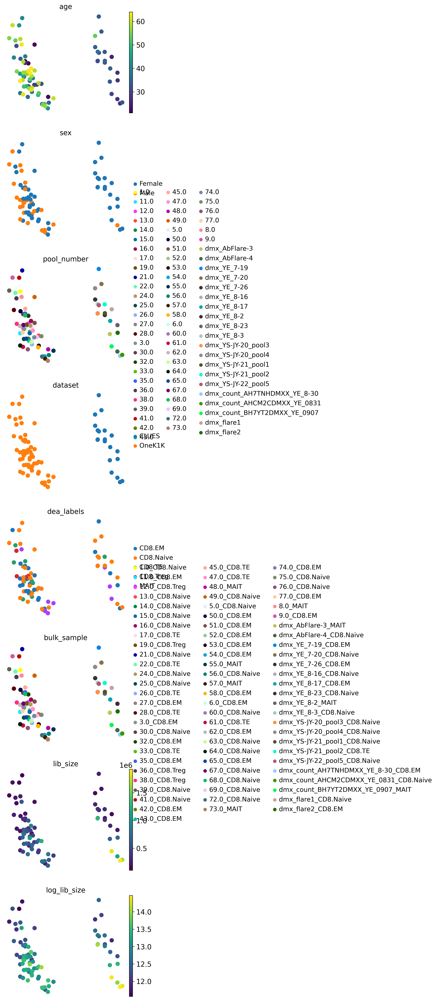

In [213]:
sc.pl.pca(adata_pb, color=adata_pb.obs, ncols=1, size=300)

In [214]:
adata_pb.X = adata_pb.layers['counts'].copy()

In [215]:
adata_pb.X = adata_pb.X.astype('float')
adata_pb.X = sparse.csr_matrix(adata_pb.X)

In [216]:
adata_pb.layers['counts'] = adata_pb.layers['counts'].astype('float')
adata_pb.layers['counts'] = sparse.csr_matrix(adata_pb.layers['counts'])

In [217]:
%%time
%%R -i adata_pb
outs <-fit_model(adata_pb)

[1] "Dimensions before subsetting:"
[1] 3000   79
[1] ""
[1] "Dimensions after subsetting:"
[1] 1128   79
[1] ""
CPU times: user 594 ms, sys: 8.01 ms, total: 602 ms
Wall time: 598 ms


In [218]:
%%R
fit <- outs$fit
y <- outs$y

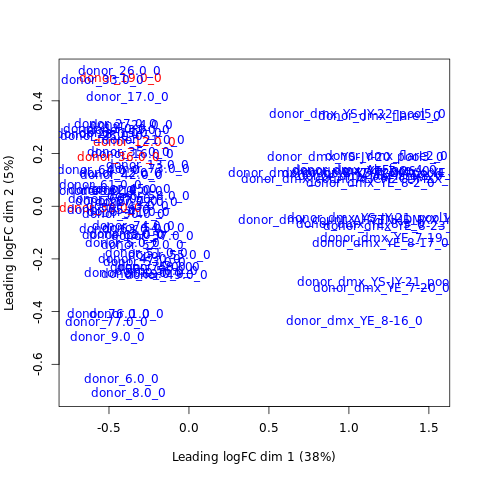

In [219]:
%%R
plotMDS(y, col=ifelse(y$samples$group == "CD8.Treg", "red", "blue"))

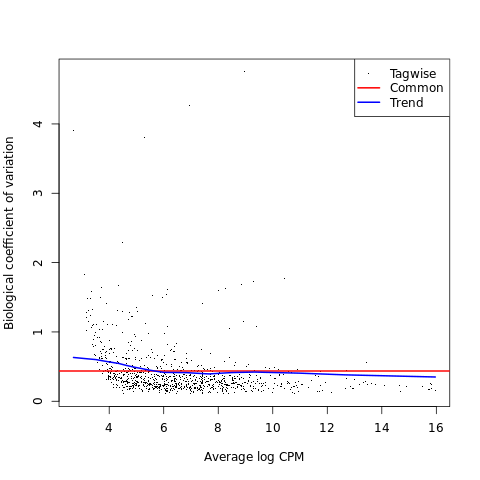

In [220]:
%%R
plotBCV(y)

In [221]:
%%R
colnames(y$design)

[1] "cell_typeCD8.EM"    "cell_typeCD8.Naive" "cell_typeCD8.TE"   
[4] "cell_typeCD8.Treg"  "cell_typeMAIT"     


In [244]:
%%R -o tt
# pairs <- c("cell_typeCD8.Treg-cell_typeCD8.EM", "cell_typeCD8.Treg-cell_typeCD8.TE",
#            "cell_typeCD8.Treg-cell_typeCD8.Naive", "cell_typeCD8.Treg-cell_typeMAIT")
myContrast <- makeContrasts(contrasts="cell_typeCD8.EM-cell_typeCD8.Naive", levels = y$design)
qlf <- glmQLFTest(fit, contrast=myContrast)
# get all of the DE genes and calculate Benjamini-Hochberg adjusted FDR
tt <- topTags(qlf, n = Inf, adjust.method='fdr', p.value=1)
tt <- tt$table

In [245]:
tt.shape

(1128, 5)

In [246]:
tt

,logFC,logCPM,F,PValue,FDR
CHI3L2,-0.525830,5.988533,10.067465,0.002159,0.995186
OAS1,-0.613146,5.026973,9.425475,0.002943,0.995186
RPL39L,0.760705,6.012578,8.119076,0.005599,0.995186
BID,-0.199458,7.097333,8.055710,0.005779,0.995186
CTC-425F1.4,0.867758,4.863777,8.014005,0.005900,0.995186
...,...,...,...,...,...
AC018816.3,0.000988,4.183761,0.000027,0.995905,0.998293
IL7R,0.000464,11.076036,0.000026,0.995982,0.998293
XCL2,-0.000815,7.124047,0.000019,0.996523,0.998293
DPYSL2,-0.000728,4.925961,0.000008,0.997739,0.998624


In [229]:
tt[tt.PValue < 0.05]

,logFC,logCPM,F,PValue,FDR
CHI3L2,-0.525830,5.988533,10.067465,0.002159,0.995186
OAS1,-0.613146,5.026973,9.425475,0.002943,0.995186
RPL39L,0.760705,6.012578,8.119076,0.005599,0.995186
BID,-0.199458,7.097333,8.055710,0.005779,0.995186
CTC-425F1.4,0.867758,4.863777,8.014005,0.005900,0.995186
ITGAM,0.368742,5.642112,6.573194,0.012273,0.995186
MIR22HG,0.348577,4.575156,6.345385,0.013812,0.995186
HLA-B,0.205181,14.106163,5.771000,0.018668,0.995186
ISG15,-0.198218,8.797098,5.403159,0.022701,0.995186
HBB,-1.400112,7.430730,5.244556,0.024716,0.995186
